# EDA Estado de Florida - Dataset de Reseñas de Google

Este informe se dá en el marco del 2º Sprint

Importamos librerias y realizamos analisis preliminar

In [308]:
import pandas as pd
import missingno as msno
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import re
import seaborn as sns
import numpy as np
from textblob import TextBlob
import warnings
warnings.filterwarnings('ignore')
import folium
from folium.plugins import HeatMap
from IPython.display import display

In [309]:
ruta = "FINAL_FLORIDA.parquet"
df = pd.read_parquet(ruta)
df.head(2)

,business_name,address,description,latitude,longitude,category,avg_rating,num_of_reviews,price,hours,MISC,state,user_name,time,rating,text
1,Honduras Nica Cafe,"Honduras Nica Cafe, 280 NW 79th St, Miami, FL ...",None,25.847143,-80.20237,['Honduran restaurant'],3.5,84,None,"[[Thursday, 7AM–9PM], [Friday, 7AM–10PM], [Sat...",{'Accessibility': ['Wheelchair accessible entr...,Closes soon ⋅ 9PM ⋅ Opens 7AM Fri,Cindys 4luvz,17/04/2021,4.0,The nacatamal is a good size and taste ok. The...
2,Honduras Nica Cafe,"Honduras Nica Cafe, 280 NW 79th St, Miami, FL ...",None,25.847143,-80.20237,['Honduran restaurant'],3.5,84,None,"[[Thursday, 7AM–9PM], [Friday, 7AM–10PM], [Sat...",{'Accessibility': ['Wheelchair accessible entr...,Closes soon ⋅ 9PM ⋅ Opens 7AM Fri,Ash Jay,07/06/2021,5.0,Love this place thats my favorite place


In [310]:
df.columns

Index(['business_name', 'address', 'description', 'latitude', 'longitude',
       'category', 'avg_rating', 'num_of_reviews', 'price', 'hours', 'MISC',
       'state', 'user_name', 'time', 'rating', 'text'],
      dtype='object')

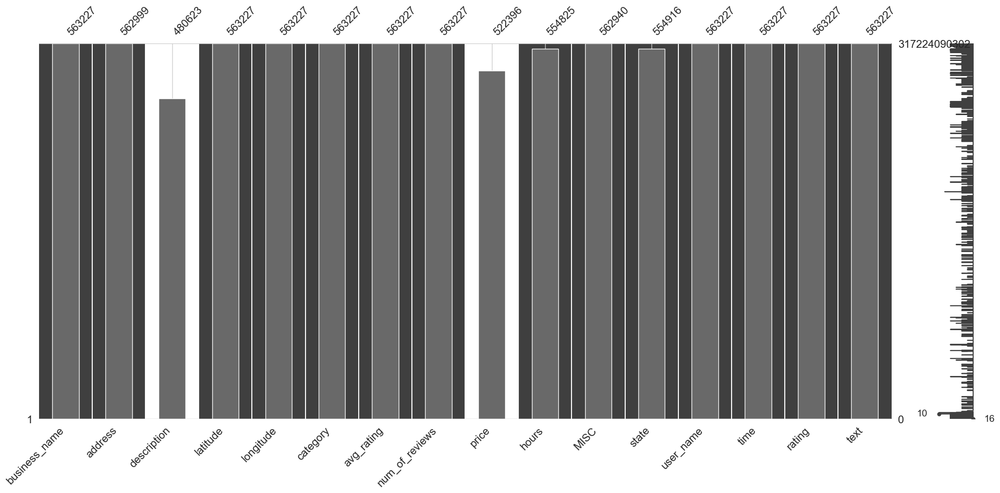

In [311]:
msno.matrix(df)
msno.bar(df)
plt.show()

Para este EDA quitamos las columnas "description" y "price". Quitamos los valores dentro de la columa "state" que "Temporarily closed"

In [312]:
df = df.dropna(subset=['description', 'price'])
df = df[df['state'] != 'Temporarily closed']

In [313]:
#corregimos valores de moneda
def replace_currency_symbol(value):
    if value is not None and "₩" in value:
        return value.replace("₩", "$")
    else:
        return value

df["price"] = df["price"].apply(replace_currency_symbol)

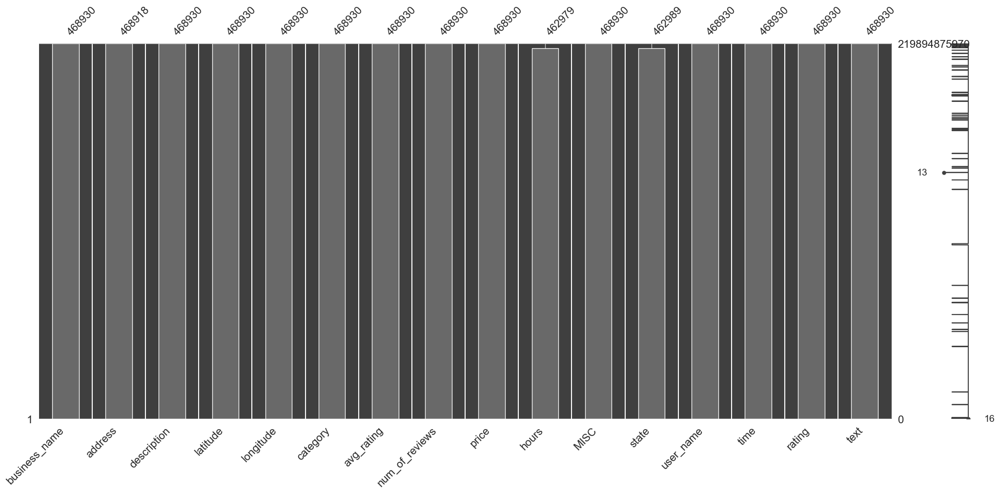

In [314]:
msno.matrix(df)
msno.bar(df)
plt.show()

In [315]:
pd.options.display.max_rows = 70

## Reviews 

En el siguiente gráfico podemos conocer la distribución de Reviews por Negocio

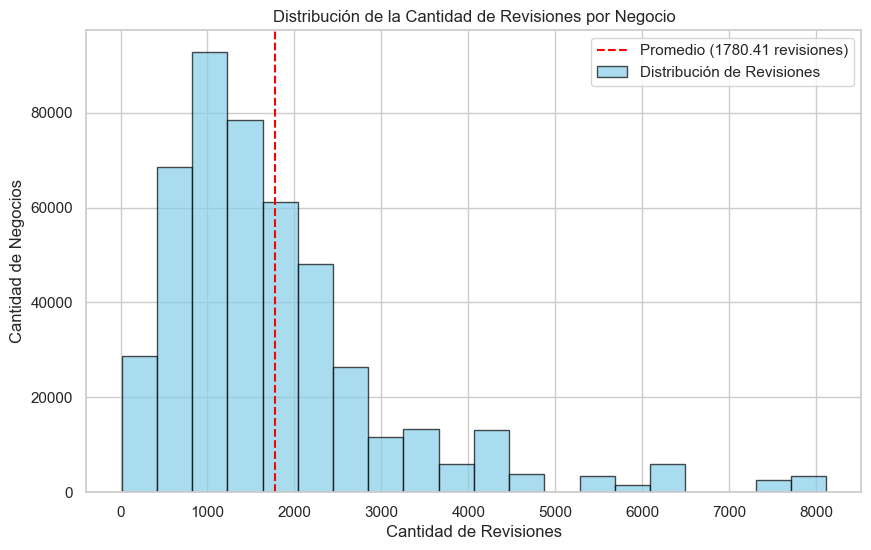

In [316]:
umbral_revisiones = 1
negocios_con_revisiones = df[df['num_of_reviews'] > umbral_revisiones]
cantidad_negocios_con_revisiones = len(negocios_con_revisiones)

plt.figure(figsize=(10, 6))
plt.hist(df['num_of_reviews'], bins=20, color='skyblue', edgecolor='black', alpha=0.7, label='Distribución de Revisiones')

# promedio
promedio_revisiones = df['num_of_reviews'].mean()
# revisiones umbral
plt.axvline(x=promedio_revisiones, color='red', linestyle='--', label=f'Promedio ({promedio_revisiones:.2f} revisiones)')

#plt.axvline(x=umbral_revisiones, color='green', linestyle='--', label=f'Umbral ({umbral_revisiones} revisiones)')
plt.xlabel('Cantidad de Revisiones')
plt.ylabel('Cantidad de Negocios')
plt.title('Distribución de la Cantidad de Revisiones por Negocio')
plt.legend()
plt.grid(True)

plt.show()

### Sentimiento de las Reviews

Con la aplicación de la libreria TextBlob podemos conocer como se distribuyen los sentimientos de las revisiones de restaurants

In [317]:
df['text'].fillna('', inplace=True)

# Define una función para obtener el sentimiento de un texto
def obtener_sentimiento(texto):
    analysis = TextBlob(texto)
    if analysis.sentiment.polarity > 0:
        return "Positivo"
    elif analysis.sentiment.polarity == 0:
        return "Neutral"
    else:
        return "Negativo"

# Aplica la función a la columna 'text' y crea una nueva columna 'sentimiento'
df['sentimiento_cat'] = df['text'].apply(obtener_sentimiento)

In [318]:
df["sentimiento_cat"].value_counts()

Positivo    387531
Negativo     52006
Neutral      29393
Name: sentimiento_cat, dtype: int64

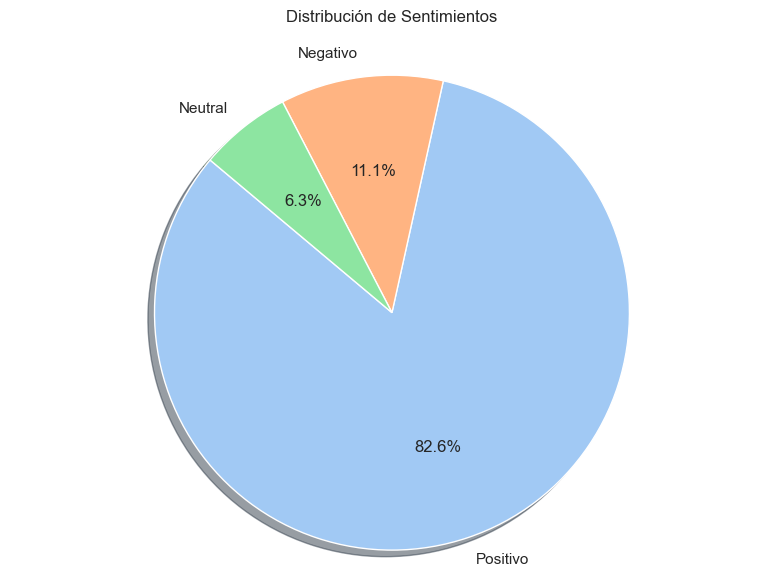

In [319]:
sentimiento_counts = df["sentimiento_cat"].value_counts().reset_index()

sns.set(style="whitegrid")

fig, ax = plt.subplots(figsize=(8, 6))
plt.gca().set_aspect('equal')
colors = sns.color_palette("pastel")
ax.pie(sentimiento_counts['sentimiento_cat'], labels=sentimiento_counts['index'], autopct='%1.1f%%', startangle=140, shadow=True, colors=colors)

plt.title('Distribución de Sentimientos', pad=20)

plt.axis('equal')
plt.tight_layout()


plt.show()

La mayoría de las reviews poseen sentimiento positivo

### Ratings

Conoceremos la cantidad de reviews por rating (puntuación) dada a la experiencia por parte de los usuarios

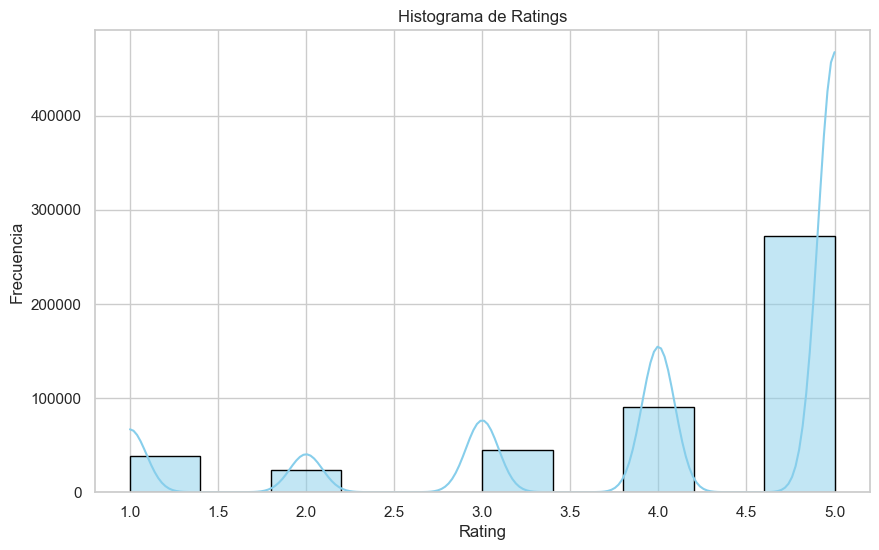

In [320]:
sns.set(style="whitegrid")
sns.set_palette("pastel")

plt.figure(figsize=(10, 6))
sns.histplot(data=df, x='rating', bins=10, color='skyblue', edgecolor='black', kde=True)
plt.xlabel('Rating')
plt.ylabel('Frecuencia')
plt.title('Histograma de Ratings')
plt.grid(True)

plt.show()

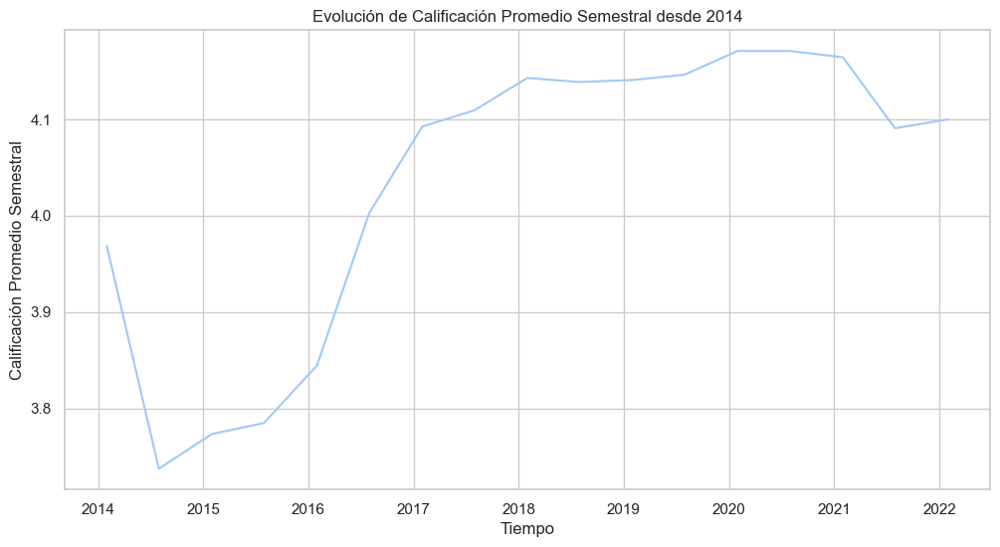

In [324]:
df['time'] = pd.to_datetime(df['time'])

# Define la fecha de inicio (enero de 2014)
fecha_inicio = pd.to_datetime('2014-01-01')

# Filtra los datos desde 2014 en adelante
df_filtrado_desde_2014 = df[df['time'] >= fecha_inicio]

plt.figure(figsize=(12, 6))

# Agrupa los datos por semestre y calcula el promedio de calificación para cada semestre
df_promedio_semestral_desde_2014 = df_filtrado_desde_2014.groupby(pd.Grouper(key='time', freq='6M'))['rating'].mean().reset_index()

# Grafica la evolución de la calificación promedio semestral
plt.plot(df_promedio_semestral_desde_2014['time'], df_promedio_semestral_desde_2014['rating'])

plt.xlabel('Tiempo')
plt.ylabel('Calificación Promedio Semestral')
plt.title('Evolución de Calificación Promedio Semestral desde 2014')
plt.grid(True)
plt.show()

### Precio

Analizaremos los rangos de precio y su relación con otras variables

In [325]:
# Función para asignar categorías de precio
def categorize_price(price):
    if price == '$':
        return 'Bajo'
    elif price == '$$':
        return 'Medio'
    elif price == '$$$':
        return 'Alto'
    elif price == '$$$$':
        return 'Muy Alto'
    else:
        return 'Desconocido'  # Maneja valores inesperados, si los hay

# Aplicar la función para crear la nueva columna 'price_category'
df['price_category'] = df['price'].apply(categorize_price)

In [326]:
df["price_category"].value_counts()

Medio       235463
Bajo        215331
Alto         14170
Muy Alto      3966
Name: price_category, dtype: int64

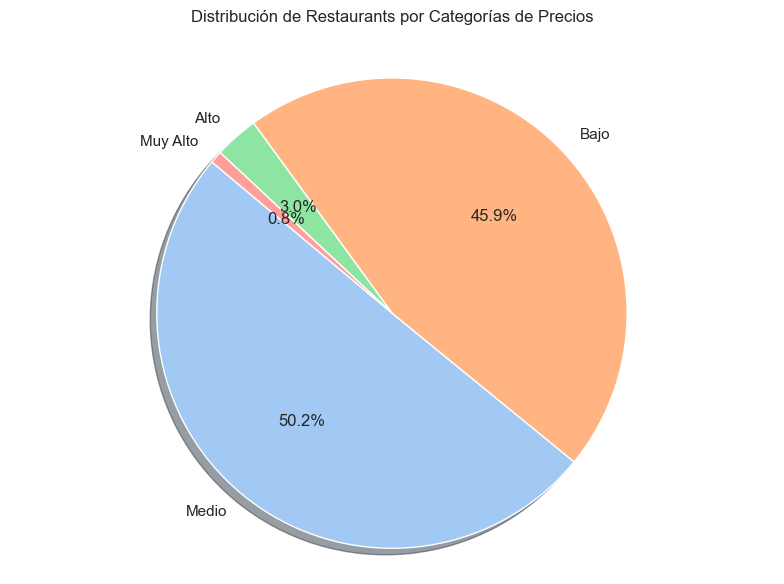

In [327]:
sentimiento_counts = df["price_category"].value_counts().reset_index()

sns.set(style="whitegrid")

fig, ax = plt.subplots(figsize=(8, 6))
plt.gca().set_aspect('equal')
colors = sns.color_palette("pastel")
ax.pie(sentimiento_counts['price_category'], labels=sentimiento_counts['index'], autopct='%1.1f%%', startangle=140, shadow=True, colors=colors)

plt.title('Distribución de Restaurants por Categorías de Precios', pad=20)

plt.axis('equal')
plt.tight_layout()


plt.show()

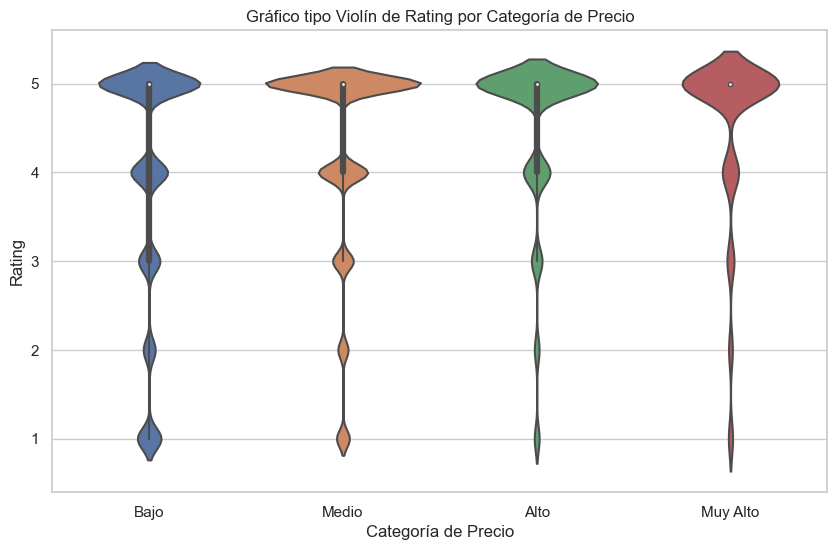

In [328]:
plt.figure(figsize=(10, 6))
sns.violinplot(x = "price_category", y = "rating", data = df, height=5, aspect=2)
plt.xlabel('Categoría de Precio')
plt.ylabel('Rating')
plt.title('Gráfico tipo Violín de Rating por Categoría de Precio')
plt.show()

Le agregamos polaridad en el sentimiento, para conocer la distribución dentro de cada rating

In [329]:
# Define una función para obtener el sentimiento de un texto
def obtener_sentimiento_bin(texto):
    analysis = TextBlob(texto)
    if analysis.sentiment.polarity > 0:
        return "Positivo"
    else:
        return "Negativo"

# Aplica la función a la columna 'text' y crea una nueva columna 'sentimiento'
df['sentimiento_cat_bin'] = df['text'].apply(obtener_sentimiento_bin)

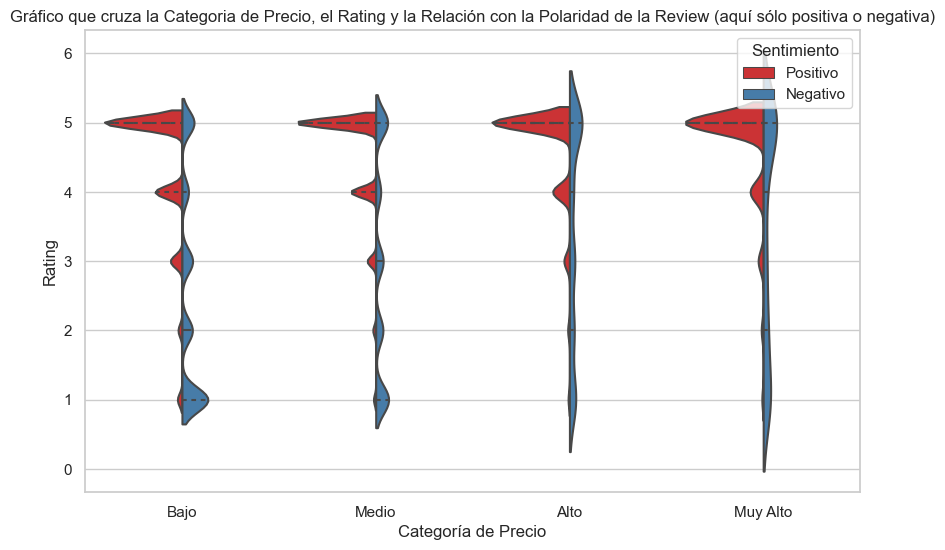

In [331]:
palette = sns.color_palette("Set1", len(df['sentimiento_cat_bin'].unique()))  # Paleta de colores única para cada categoría

# Crear el gráfico de violín con colores basados en "sentimiento"
plt.figure(figsize=(10, 6))
sns.violinplot(x="price_category", y="rating", data=df, hue="sentimiento_cat_bin", palette=palette, split=True, inner="quart")
plt.xlabel('Categoría de Precio')
plt.ylabel('Rating')
plt.title('Gráfico que cruza la Categoria de Precio, el Rating y la Relación con la Polaridad de la Review (aquí sólo positiva o negativa)')
plt.legend(title='Sentimiento')  # Agregar una leyenda

plt.show()

Existen buenas puntuaciones de rating que poseen en su texto menciones con polaridad negativa

### Análisis Particular de Reviews de Restaurants

Analizaremos el comportamiento de las reviews y rating de los restaurantes que poseen más de 1000 reviews

In [332]:
dist_com = df["business_name"].value_counts()

In [333]:
dist_com

McDonald's                                                 36700
Wendy's                                                    11072
Chick-fil-A                                                 9226
IHOP                                                        8089
Steak 'n Shake                                              7126
                                                           ...  
Wing Zone                                                      7
¡Ole!                                                          6
Puerto Gallego Inc                                             5
Bluefire Grille                                                5
McDonald's - NEW LOCATION (next to Walgreen's) NOW OPEN        5
Name: business_name, Length: 693, dtype: int64

In [334]:
df.columns

Index(['business_name', 'address', 'description', 'latitude', 'longitude',
       'category', 'avg_rating', 'num_of_reviews', 'price', 'hours', 'MISC',
       'state', 'user_name', 'time', 'rating', 'text', 'sentimiento_cat',
       'price_category', 'sentimiento_cat_bin'],
      dtype='object')

In [335]:
dist_ad = df["address"].value_counts()
temp = dist_ad[dist_ad > 1000]
temp2 = temp.index.to_list()
restaurants_mas_1000_rev = df[df.address.isin(temp2)]

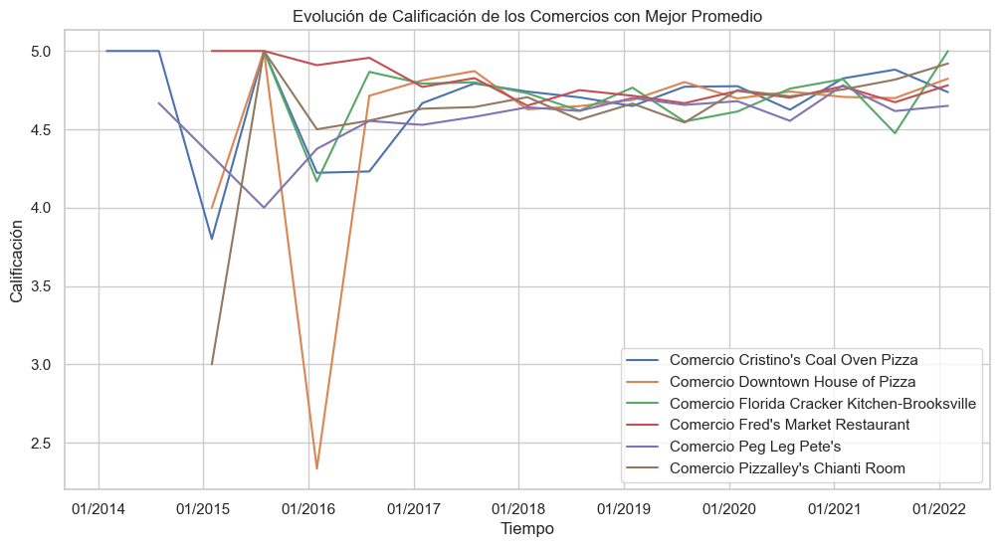

In [336]:
n = 6

restaurants_mas_1000_rev.loc[:, 'time'] = pd.to_datetime(restaurants_mas_1000_rev['time'], errors='coerce').values
# Filtra los datos desde el año 2014
restaurants_mas_1000_rev = restaurants_mas_1000_rev[restaurants_mas_1000_rev['time'].dt.year >= 2014]

# Calcula el promedio de calificación para cada comercio en el período
promedios_comercios = restaurants_mas_1000_rev.groupby('business_name')['rating'].mean()

# Ordena los comercios por su calificación promedio en orden descendente
comercios_mejor_promedio = promedios_comercios.sort_values(ascending=False).head(n) 

# Filtra los datos solo para los comercios con los puntajes promedio más altos
df_comercios_mejor_promedio = restaurants_mas_1000_rev[restaurants_mas_1000_rev['business_name'].isin(comercios_mejor_promedio.index)]

df_comercios_mejor_promedio = df_comercios_mejor_promedio.groupby(["business_name", pd.Grouper(key="time", freq="6M")])["rating"].mean().reset_index()
plt.figure(figsize=(12, 6))

for comercio, datos_comercio in df_comercios_mejor_promedio.groupby('business_name'):
    plt.plot(datos_comercio['time'], datos_comercio['rating'], label=f'Comercio {comercio}')

plt.gca().xaxis.set_major_locator(mdates.YearLocator(base=1, month=1))  # Muestra solo los años, comenzando en enero
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%m/%Y'))  # Formato de mes/año

plt.xlabel('Tiempo')
plt.ylabel('Calificación')
plt.title('Evolución de Calificación de los Comercios con Mejor Promedio')
plt.legend()
plt.grid(True)
plt.show()

Se puede ver la evolución del rating otorgado a cada restaurant. Es información valiosa para conocer la evolución en las reseñas. Podemos conocer cuál ha sido su volatilidad o variabilidad en el comportamiento. Es decir, cuanto sube-baja han tenido las reseñas.

In [337]:
desv_std = df_comercios_mejor_promedio.groupby("business_name")["rating"].std().reset_index()
desv_std.columns = ['Restaurant','DesviacionStd']
desv_std

,Restaurant,DesviacionStd
0,Cristino's Coal Oven Pizza,0.315730
1,Downtown House of Pizza,0.648898
2,Florida Cracker Kitchen-Brooksville,0.218318
3,Fred's Market Restaurant,0.118656
4,Peg Leg Pete's,0.183428
5,Pizzalley's Chianti Room,0.459703


Encontramos una variable muy valiosa para poder conocer o predecir el comportamiento de un restaurant y acercarle al cliente información sobre si la experiencia que tendrá se encuentra dentro de valores posibles de la escala de puntuación que espera

### NLP

Aplicaremos con la librería TextBlob análisis de sentimiennto de los textos de las reseñas. 

En el siguiente gráfico mostramos la relación que existe entre los Sentimientos (polaridad numérica, entre -1 (negativo) y 1(positivo)) y las calificaciones brindadas (reviews)

In [338]:
# Función para obtener la polaridad del texto
def obtener_sentimiento(texto):
    analysis = TextBlob(texto)
    return analysis.sentiment.polarity


df['sentimiento'] = df['text'].apply(obtener_sentimiento)

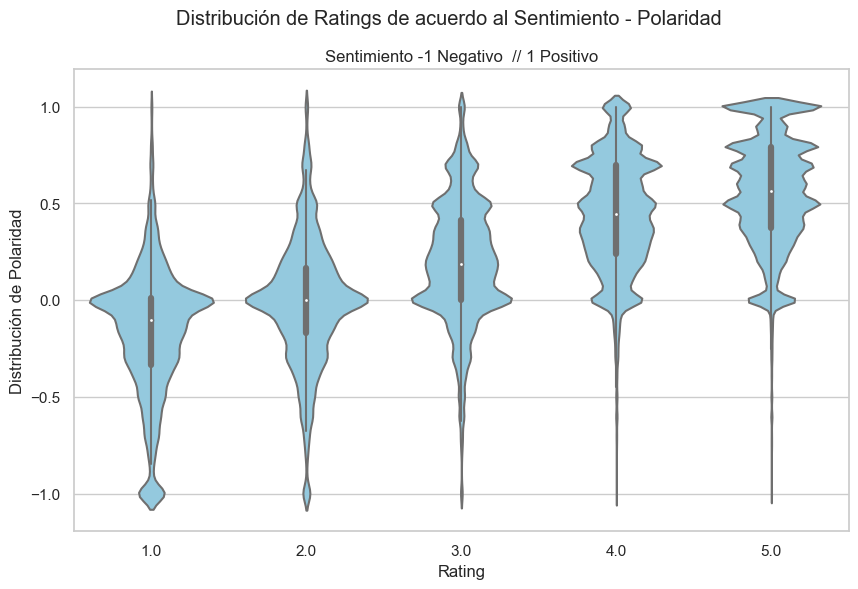

In [339]:
sns.set(style="whitegrid")
sns.set_palette("pastel")

plt.figure(figsize=(10, 6))
sns.violinplot(data=df, x='rating', y="sentimiento", color='skyblue', kind="violin", cut=2)
plt.xlabel('Rating')
plt.ylabel('Distribución de Polaridad')
plt.suptitle('Distribución de Ratings de acuerdo al Sentimiento - Polaridad')
plt.title("Sentimiento -1 Negativo  // 1 Positivo")
plt.show()

Observamos que existe relación entre los sentimientos inferidos por los comentarios y el ranking que dicho usuario le coloca

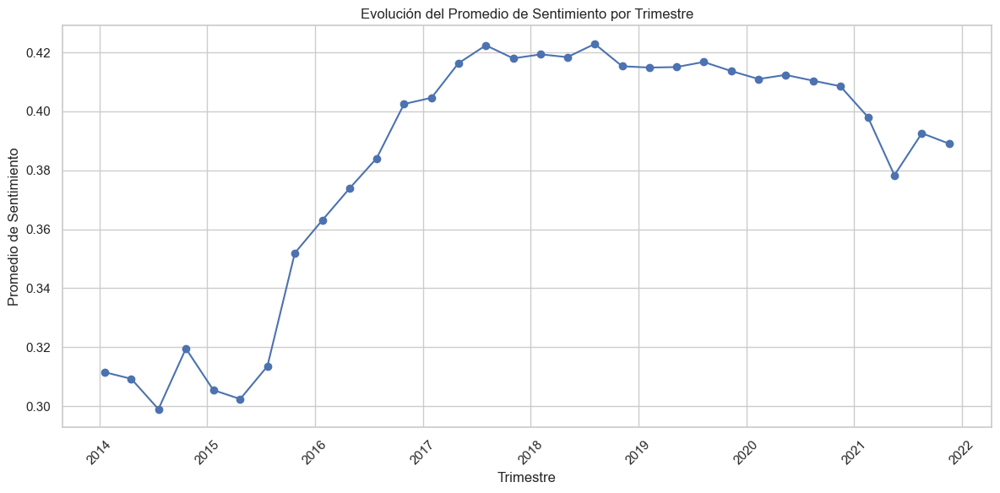

In [340]:
df['time'] = pd.to_datetime(df['time'])

resultados_trimestrales = pd.DataFrame(columns=['Trimestre', 'Promedio_Sentimiento'])

fecha_inicio = pd.to_datetime('2014-01-18')
fecha_fin = pd.to_datetime('2021-12-08')

intervalo = pd.DateOffset(months=3)

# Itera a través de los trimestres
while fecha_inicio <= fecha_fin:
    # Calcula la fecha de fin del trimestre
    fecha_fin_trimestre = fecha_inicio + intervalo
    
    # Filtra los datos para el trimestre actual
    trimestre_actual = (df['time'] >= fecha_inicio) & (df['time'] <= fecha_fin_trimestre)
    datos_trimestre = df[trimestre_actual]
    
    # Calcula el promedio de sentimiento para el trimestre actual
    promedio_sentimiento = datos_trimestre['sentimiento'].mean()
    
    # Agrega los resultados al DataFrame de resultados trimestrales
    resultados_trimestrales = resultados_trimestrales.append({'Trimestre': fecha_inicio, 'Promedio_Sentimiento': promedio_sentimiento}, ignore_index=True)
    
    # Avanza al próximo trimestre
    fecha_inicio = fecha_fin_trimestre + pd.DateOffset(days=1)
    
resultados_trimestrales

# Convierte la columna 'Trimestre' a formato de fecha
resultados_trimestrales['Trimestre'] = pd.to_datetime(resultados_trimestrales['Trimestre'])

# Crea el gráfico de línea
plt.figure(figsize=(12, 6))
plt.plot(resultados_trimestrales['Trimestre'], resultados_trimestrales['Promedio_Sentimiento'], marker='o', linestyle='-', color='b')

plt.xlabel('Trimestre')
plt.ylabel('Promedio de Sentimiento')
plt.title('Evolución del Promedio de Sentimiento por Trimestre')
plt.grid(True)
plt.xticks(rotation=45) 

plt.tight_layout()
plt.show()

En el gráfico anterior vemos la evolución del indice de polaridad en el tiempo (trimestres); se observa como se fue comportando la opcinión de las personas que dieron su review. 

### Cruce entre Rating y NLP

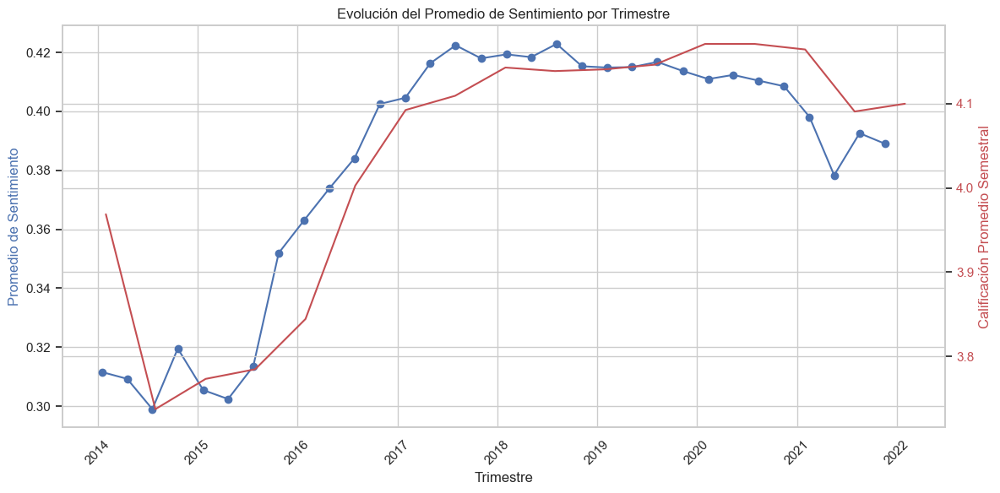

In [342]:
# 1er gráfico - Promedio de Sentimiento por Trimestre
df1 = resultados_trimestrales
df1['Trimestre'] = pd.to_datetime(df1['Trimestre'])

fig, ax1 = plt.subplots(figsize=(12, 6))

ax1.plot(df1['Trimestre'], df1['Promedio_Sentimiento'], marker='o', linestyle='-', color='b')
ax1.set_xlabel('Trimestre')
ax1.set_ylabel('Promedio de Sentimiento', color='b')
ax1.set_title('Evolución del Promedio de Sentimiento por Trimestre')
ax1.grid(True)
ax1.tick_params(axis='x', rotation=45)

# 2do gráfico - Calificación Promedio Semestral desde 2014
df2 = df
df2['time'] = pd.to_datetime(df2['time'], unit='ms')
fecha_inicio = pd.to_datetime('2014-01-01')
df2_filtrado_desde_2014 = df2[df2['time'] >= fecha_inicio]

ax2 = ax1.twinx()  # Crea un segundo eje y en la misma figura

df2_promedio_semestral_desde_2014 = df2_filtrado_desde_2014.groupby(pd.Grouper(key='time', freq='6M'))['rating'].mean().reset_index()
ax2.plot(df2_promedio_semestral_desde_2014['time'], df2_promedio_semestral_desde_2014['rating'], color='r')

ax2.set_ylabel('Calificación Promedio Semestral', color='r')
ax2.tick_params(axis='y', labelcolor='r')

plt.tight_layout()
plt.show()

Y que pasaría si agregamos al gráfico la cantidad de reviews? como se han comportado estas variables?

In [360]:
revisiones_trimestrales = df.groupby(pd.Grouper(freq='Q', key='time'))['time'].count()

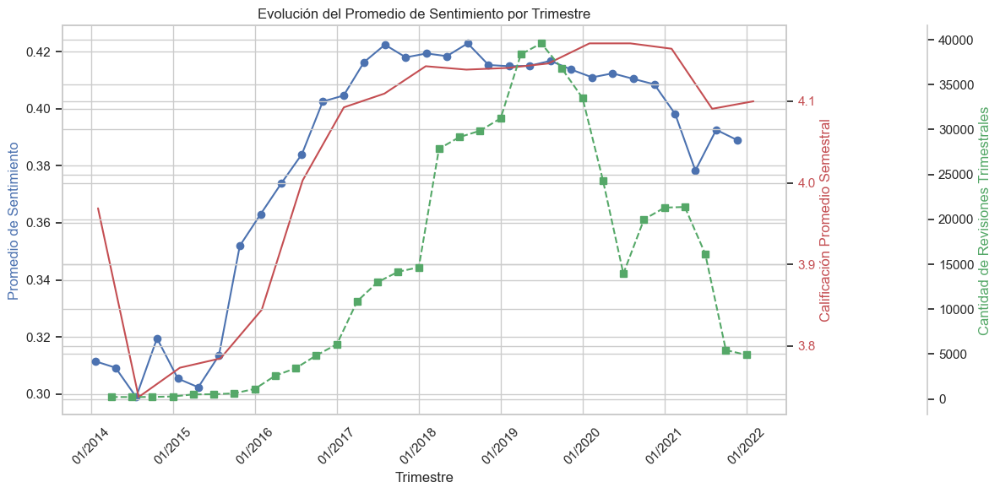

In [359]:
df1 = resultados_trimestrales
df1['Trimestre'] = pd.to_datetime(df1['Trimestre'])

fig, ax1 = plt.subplots(figsize=(12, 6))

ax1.plot(df1['Trimestre'], df1['Promedio_Sentimiento'], marker='o', linestyle='-', color='b')
ax1.set_xlabel('Trimestre')
ax1.set_ylabel('Promedio de Sentimiento', color='b')
ax1.set_title('Evolución del Promedio de Sentimiento por Trimestre')
ax1.grid(True)
ax1.tick_params(axis='x', rotation=45)

df2 = df
df2['time'] = pd.to_datetime(df2['time'], unit='ms')
fecha_inicio = pd.to_datetime('2014-01-01')
df2_filtrado_desde_2014 = df2[df2['time'] >= fecha_inicio]

ax2 = ax1.twinx()  # Crea un segundo eje y en la misma figura

df2_promedio_semestral_desde_2014 = df2_filtrado_desde_2014.groupby(pd.Grouper(key='time', freq='6M'))['rating'].mean().reset_index()
ax2.plot(df2_promedio_semestral_desde_2014['time'], df2_promedio_semestral_desde_2014['rating'], color='r')

ax2.set_ylabel('Calificación Promedio Semestral', color='r')
ax2.tick_params(axis='y', labelcolor='r')

# 3er gráfico - Cantidad de Revisiones Trimestrales desde 2014
ax3 = ax1.twinx()
ax3.spines['right'].set_position(('outward', 120)) 
ax3.set_ylabel('Cantidad de Revisiones Trimestrales', color='g')

revisiones_trimestrales_desde_2014 = revisiones_trimestrales[revisiones_trimestrales.index >= '2014-01-01']
ax3.plot(revisiones_trimestrales_desde_2014.index, revisiones_trimestrales_desde_2014.values, marker='s', linestyle='--', color='g')

ax3.xaxis.set_major_locator(mdates.YearLocator(base=1, month=1)) 
ax3.xaxis.set_major_formatter(mdates.DateFormatter('%m/%Y'))  
ax3.tick_params(axis='x', rotation=45)
ax3.grid(True)

plt.tight_layout()

plt.show()

Se puede observar en el último gráfico que el promedio de puntuación de los usuarios que informaron su puntaje ha sido menor. Es decir, hubo menos opiniones y estas fueron más negativas. Se analizó en los restaurantes con más reviews que la variable precio no haya sido la que dificultó el bajo rating que se comenzó a otorgar. 

### NLP - Nube de Palabras

Indagamos sobre las palabras que más se repiten en las opiniones en los períodos trimestrales 4º 2020, 1º 2021 y 2º 2021

In [379]:
# Filtra los datos del último semestre de 2020
df = df_filtrado_desde_2014

# Filtra los datos del último trimestre de 2020
ultimo_trimestre_2020 = (df['time'] >= '2020-10-01') & (df['time'] <= '2020-12-31')
datos_ultimo_trimestre_2020 = df[ultimo_trimestre_2020].copy()

# Filtra los datos del primer semestre de 2021
primer_trimestre_2021 = (df['time'] >= '2021-01-01') & (df['time'] <= '2021-03-30')
datos_primer_trimestre_2021 = df[primer_trimestre_2021].copy()

# Filtra los datos del segundo semestre de 2021
segundo_trimestre_2021 = (df['time'] >= '2021-04-01') & (df['time'] <= '2021-06-30')
datos_segundo_trimestre_2021 = df[segundo_trimestre_2021].copy()

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/tinpenas/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


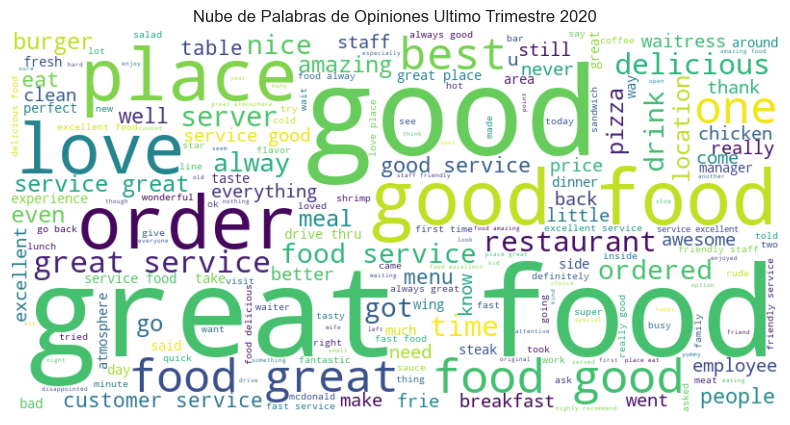

In [380]:
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from wordcloud import WordCloud

# Supongamos que tienes un DataFrame llamado 'df' con una columna 'text' que contiene las opiniones.
# Carga tus datos o asegúrate de que 'df' contenga las opiniones.

# Descarga las stopwords (palabras vacías) de NLTK
import nltk
nltk.download('stopwords')

# Carga las stopwords en español
stop_words = set(stopwords.words('english', 'spanish'))

custom_stopwords = ["google", "translated", "de", "la"]

stop_words.update(custom_stopwords)

# Función para preprocesar y limpiar el texto
def preprocess_text(text):
    # Tokeniza el texto
    words = word_tokenize(text.lower())  # Convierte a minúsculas
    
    # Filtra las stopwords y los signos de puntuación
    filtered_words = [word for word in words if word.isalnum() and word not in stop_words]
    
    return " ".join(filtered_words)

# Aplica la función de preprocesamiento a la columna 'text'
datos_ultimo_trimestre_2020['clean_text'] = datos_ultimo_trimestre_2020['text'].apply(preprocess_text)

# Combina todas las opiniones limpias en un solo texto
all_clean_text = " ".join(datos_ultimo_trimestre_2020['clean_text'])

# Crea una nube de palabras
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_clean_text)

# Visualiza la nube de palabras
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Nube de Palabras de Opiniones Ultimo Trimestre 2020')
plt.show()

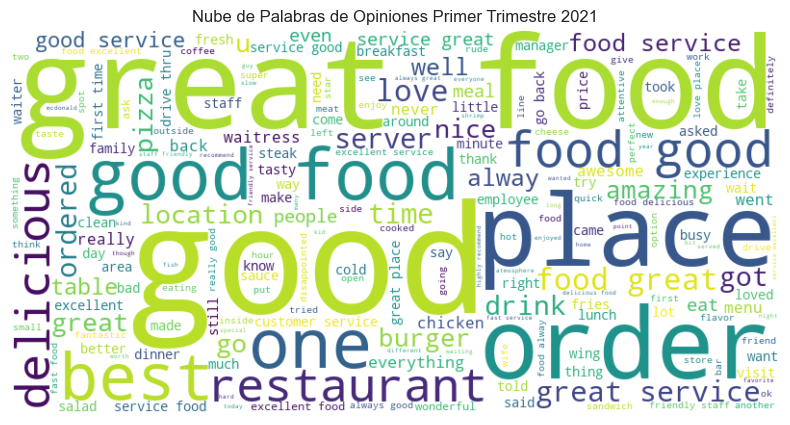

In [381]:
# Carga las stopwords en español
stop_words = set(stopwords.words('english', 'spanish'))

custom_stopwords = ["google", "translated", "de", "la"]

stop_words.update(custom_stopwords)

# Función para preprocesar y limpiar el texto
def preprocess_text(text):
    # Tokeniza el texto
    words = word_tokenize(text.lower())  # Convierte a minúsculas
    
    # Filtra las stopwords y los signos de puntuación
    filtered_words = [word for word in words if word.isalnum() and word not in stop_words]
    
    return " ".join(filtered_words)

# Aplica la función de preprocesamiento a la columna 'text'
datos_segundo_trimestre_2021['clean_text'] = datos_segundo_trimestre_2021['text'].apply(preprocess_text)

# Combina todas las opiniones limpias en un solo texto
all_clean_text = " ".join(datos_segundo_trimestre_2021['clean_text'])

# Crea una nube de palabras
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_clean_text)

# Visualiza la nube de palabras
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Nube de Palabras de Opiniones Primer Trimestre 2021')
plt.show()

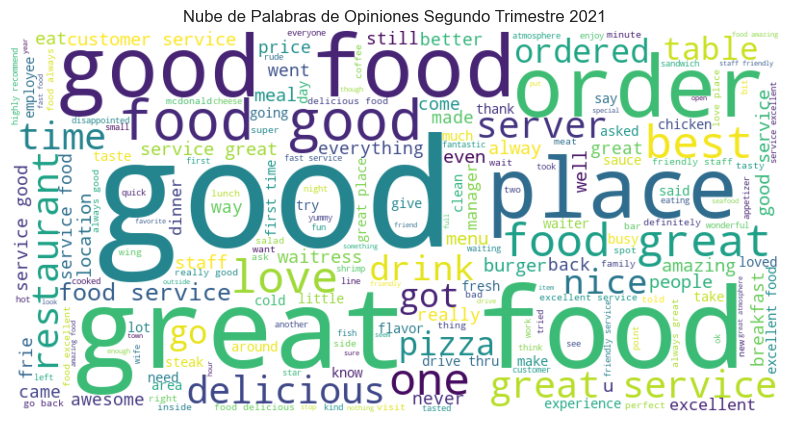

In [382]:
# Carga las stopwords en español
stop_words = set(stopwords.words('english', 'spanish'))

custom_stopwords = ["google", "translated", "de", "la"]

stop_words.update(custom_stopwords)

# Función para preprocesar y limpiar el texto
def preprocess_text(text):
    # Tokeniza el texto
    words = word_tokenize(text.lower())  # Convierte a minúsculas
    
    # Filtra las stopwords y los signos de puntuación
    filtered_words = [word for word in words if word.isalnum() and word not in stop_words]
    
    return " ".join(filtered_words)

# Aplica la función de preprocesamiento a la columna 'text'
datos_primer_trimestre_2021['clean_text'] = datos_primer_trimestre_2021['text'].apply(preprocess_text)

# Combina todas las opiniones limpias en un solo texto
all_clean_text = " ".join(datos_primer_trimestre_2021['clean_text'])

# Crea una nube de palabras
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_clean_text)

# Visualiza la nube de palabras
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Nube de Palabras de Opiniones Segundo Trimestre 2021')
plt.show()

No encontramos que las palabras más mencionadas que surgieron en el primer y segundo trimestre se hayan relacionado hacia menciones negtivas. 

### Datos Geográficos

En el siguiente mapa conocemos la distribución y acumulación de las reviews a lo largo del mapa de Florida. En color rojo, los lugares donde existe mayor reviews

In [393]:
df['coord_count'] = df.groupby(['latitude', 'longitude']).transform('size')

m = folium.Map(location=[27.9944024, -81.7602544], zoom_start=6)  # Estas coordenadas centran el mapa en Florida

# Las filas con mayor conteo tendrán mayor peso en el heatmap
heat_data = [[row['latitude'], row['longitude'], row['coord_count']] for index, row in df.iterrows()]

HeatMap(heat_data, radius=5, blur=3).add_to(m)

# Agregar un título al mapa usando folium.Html()
title_html = """
<h3 align="center" style="font-size:16px"><b>Acumulación de Reviews</b></h3>
"""
m.get_root().html.add_child(folium.Element(title_html))

display(m)

En el siguiente mapa vemos la acumulación de restaurantes de manera geográfica

In [376]:
# Contar las repeticiones de cada combinación de latitud y longitud
df['latlong_count'] = df.groupby(['latitude', 'longitude']).transform('count').iloc[:, 0]

df['log_count'] = np.log(df['latlong_count'] + 1)

m = folium.Map(location=[27.9944024, -81.7602544], zoom_start=7)

heat_data = [[row['latitude'], row['longitude'], row['log_count']] for index, row in df.iterrows()]

HeatMap(heat_data, radius=5, blur=3, gradient={0.4: 'blue', 0.65: 'lime', 1: 'red'}).add_to(m)

# Agregar un título al mapa usando folium.Html()
title_html = """
<h3 align="center" style="font-size:16px"><b>Acumulación de Restaurantes</b></h3>
"""
m.get_root().html.add_child(folium.Element(title_html))

# Mostrar el mapa
display(m)

Esta visualización nos permite ver como se distribuyen las opiniones y cantidad de restaurantes de manera geográfica. Es información valiosa que utilizaremos en el desarrollo del proyecto. 

En este EDA hemos abarcado diversas aristas del dataset que analizamos, entendiendo que tenemos información rica y valiosa en cuanto a la evolución de las opiniones y reviews.